# Тестовое задание. Детекция объектов YOLO

Датасет содержит около 300 картинок с игральными картами, данные хранятся в xml в формате PascalVOC.

## Данные

Разметка находится в xmls папке, картинки в images, в class_dict - словарь классов. Всего 6 различных классов в датасете.

In [ ]:
!wget https://github.com/markblumenau/hw3_iad_dl/raw/main/cards/data.zip
!unzip -q data.zip

--2025-02-01 12:10:04--  https://github.com/markblumenau/hw3_iad_dl/raw/main/cards/data.zip
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/markblumenau/hw3_iad_dl/main/cards/data.zip [following]
--2025-02-01 12:10:04--  https://raw.githubusercontent.com/markblumenau/hw3_iad_dl/main/cards/data.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 38392108 (37M) [application/zip]
Saving to: ‘data.zip’

data.zip            100%[===================>]  36.61M  --.-KB/s    in 0.1s    

2025-02-01 12:10:21 (295 MB/s) - ‘data.zip’ saved [38392108/38392108]



# Обработка XML файлов аннотаций. Создание датасетов.

Реализуем функцию parse_annotation для выгрузки bbox и int классов на изображении из xml файлов. Далее с помощью этой функции будет реализован ObjectDetectionDataset для формирования батчей для обучения, конкретно методы `__getitem__` и `__len__` используют чтение картинок и подттягивание аннотаций к ним.

In [ ]:
import torch
from xml.etree import ElementTree as ET
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
from pathlib import Path
import glob
import numpy as np
from PIL import Image
import torchvision
from tqdm.notebook import tqdm
from torch import nn
import shutil

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.2 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


Флоу взят из https://stackoverflow.com/questions/53317592/reading-pascal-voc-annotations-in-python

In [ ]:
def parse_annotation(image_path, root_path, label_mapping, xml_folder="/xmls/"):
    """
    Получение bbox'ов и классов объектов из XML-аннотаций

    image_path (str): Путь к изображению
    root_path (Path): Корневая папка датасета
    label_mapping (dict): Словарь классов объектов
    xml_folder (str): Папка с XML-аннотациями

    bboxes (list): Список списков bbox'ов [xmin, ymin, xmax, ymax, class_id]
    """
    # Извлечение наименования изображения
    image_name = Path(image_path).stem
    # Чтение xml
    xml_file = str(root_path) + xml_folder + image_name + ".xml"
    tree = ET.parse(xml_file)
    root = tree.getroot()
    # Итерация по bbox'ам
    bboxes = []
    for obj in root.findall("object"):
        # Сбор координат bbox'ов и извлечение int класса
        # https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/
        ymin, xmin, ymax, xmax = None, None, None, None
        ymin = int(obj.find("bndbox/ymin").text)
        xmin = int(obj.find("bndbox/xmin").text)
        ymax = int(obj.find("bndbox/ymax").text)
        xmax = int(obj.find("bndbox/xmax").text)
        class_int = int(label_mapping[obj.find("name").text])

        bboxes.append([xmin, ymin, xmax, ymax, class_int])

    return bboxes

In [ ]:
class ObjectDetectionDataset(torch.utils.data.Dataset):
    def __init__(self, *, transform, data_root="dataset", is_train=True, split_ratio=0.9, seed=42):
        """
        PyTorch Dataset для задачи детекции объектов

        transform (albumentations.Compose): Аугментации для данных
        data_root (str): Корневая папка датасета
        is_train (bool): Флаг данных для обучения/теста
        split_ratio (float): Доля данных для обучения
        seed (int): Сид для рандомизации
        """
        self.root = Path(data_root)
        self.transform = transform

        assert self.root.is_dir(), f"Нет данных в `{data_root}`"

        # Список всех наименований изображений
        self.image_paths = np.array(glob.glob(data_root + "/images/*"))

        # Маппинг int классов и их наименований
        with open(self.root / "class_dict", "r") as file:
            self.label_mapping = eval(file.readline())

        # Обратный маппинг
        self.label_mapping_inv = {v: k for k, v in self.label_mapping.items()}

        # Выборка индексов для сплита
        np.random.seed(seed)
        indices = np.random.permutation(len(self.image_paths))
        split_idx = int(len(self.image_paths) * split_ratio)

        # Train/test сплит
        if is_train:
            self.image_paths = self.image_paths[indices[:split_idx]].tolist()
        else:
            self.image_paths = self.image_paths[indices[split_idx:]].tolist()

    def __getitem__(self, idx):
        """
        Получение элемента датасета (с аугментацией)

        idx (int): Индекс элемента датасета

        transformed (dict): Обработанное изображение и бибоксы
        """
        # Подгружаем изображение и бибкосы с помощью наименования файла
        image_path = self.image_paths[idx]
        image = np.array(Image.open(image_path).convert("RGB"))
        bboxes = parse_annotation(image_path, self.root, self.label_mapping)

        transformed = self.transform(image=image, bboxes=bboxes)

        return transformed

    def __get_raw_item__(self, idx):
        """
        Возвращает сырой элемент: путь к изображению и его аннотации
        """
        image_path = self.image_paths[idx]
        raw_bboxes = parse_annotation(image_path, self.root, self.label_mapping)
        return image_path, raw_bboxes

    def __len__(self):
        """
        Длина датасета
        """
        return len(self.image_paths)

В качестве аугментаций используем нормализацию и приведение изображений к размеру 512x512.


In [ ]:
mean = (0.485, 0.456, 0.406)
std = (0.229, 0.224, 0.225)

train_transform = A.Compose(
    [
        A.Resize(512, 512),
        A.augmentations.transforms.Normalize(mean=mean, std=std),
        ToTensorV2(),
    ],
    # Хотим pascal_voc
    bbox_params=dict(format="pascal_voc", min_visibility=0.3),
)

test_transform = A.Compose(
    [
        A.Resize(512, 512),
        A.augmentations.transforms.Normalize(mean=mean, std=std),
        ToTensorV2(),
    ],
    bbox_params=dict(format="pascal_voc", min_visibility=0.5),
)

In [ ]:
train_ds = ObjectDetectionDataset(data_root="./data/", transform=train_transform, is_train=True)
test_ds = ObjectDetectionDataset(data_root="./data/", transform=test_transform, is_train=False)

# Дообучение модели YOLOv8.

Используем YOLOv8 от ultralytics. Дообучим ее на наших данных.

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.9/914.9 kB 53.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 110.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 83.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 88.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

## Перекладывание данных
Для быстрого обучения модели YOLO необходимо:

1) Создать папки train и valid, в которых будут лежать изображения в папке images и аннотации к бибоксам и int класса в .txt формате

2) Создать .yaml файл, в котором будут лежать пути к папкам с изображениями и классы

https://roboflow.com/formats/yolov8-pytorch-txt



In [ ]:
# Создаем папки
!rm -rf train
!rm -rf valid
!mkdir -p train/images train/labels valid/images valid/labels

Требуемый формат аннотаций взят из: https://roboflow.com/formats/yolov8-pytorch-txt

In [ ]:
def annotation2txt(bboxes, w_im, h_im):
    yolo_format_ann = []
    for bbox in bboxes:
        xmin, ymin, xmax, ymax, class_int = bbox
        cx = (xmin + xmax) / 2 / w_im
        cy = (ymin + ymax) / 2 / h_im
        w = (xmax - xmin) / w_im
        h = (ymax - ymin) / h_im
        yolo_format_ann.append(f"{class_int} {cx} {cy} {w} {h}")
    return yolo_format_ann

Разложим картинки по папкам и создадим текстовые файлы с классами для изображений

In [ ]:
for i in range(len(train_ds)):
    # Для каждого объекта датасета возвращаем имя изображения и координаты бибокса
    result = train_ds.__get_raw_item__(i)

    # Копируем изображение в созданную папку
    shutil.copyfile(
        result[0], f"./train/images/{Path(result[0]).name}"
    )

    # Получаем размеры изображения
    h_im, w_im, ch = np.array(Image.open(result[0])).shape

    # Создаем .txt аннотацию с int классом и координатами бибокса
    with open(
        f"./train/labels/{Path(result[0]).stem}.txt",
        "w",
        encoding="utf8",
    ) as f:
        f.write("\n".join(annotation2txt(result[1], w_im, h_im)))

for i in range(len(test_ds)):
    result = test_ds.__get_raw_item__(i)

    shutil.copyfile(
        result[0], f"./valid/images/{Path(result[0]).name}"
    )

    with open(
        f"./valid/labels/{Path(result[0]).stem}.txt",
        "w",
        encoding="utf8",
    ) as f:
        f.write("\n".join(annotation2txt(result[1], w_im, h_im)))

In [ ]:
# Собираем .yaml
nc = 6
names = ["king", "jack", "ace", "ten", "nine", "queen"]

# Записываем в .yaml классы и пути к папкам с изображениями
with open("data.yaml", "w") as f:
    f.write(f"train: ../train/images\nval: ../valid/images\n\nnc: {nc}\nnames: {names}")

## Дообучение YOLOv8


Так как мы не гонимся за качеством, используем автоматически выбранный оптимизатор AdamW с параметрами lr=0.001, momentum=0.9, затем проверим на графике сходимости ошибки, сходится ли модель и с какой скоростью. Учитывая, что используется AdamW с momentum, lr можно выбирать низкий, скорость сходимости будет хорошей.

График сходится, скорость приемлемая, качество хорошее, оставим lr по умолчанию.

Эмпирически подберем количество эпох, учитывая, что мы используем nano версию модели и отслеживая графики ошибки на train и test, чтобы избежать переобучения и недообучения. Подобранное число эпох 60.

Размер изображений установим тот, который применялся при аугментации - 512.

Batch-size выберем по умолчанию 16, так как ресурсы колаба позволяют.

Регуляризацию также оставим по умолчанию, проверив, не переобучается ли модель. В случае переобучения необходимо увеличить Weight Decay.

In [ ]:
import ultralytics
from ultralytics import YOLO

model = YOLO("yolov8n.pt")
model.train(data="data.yaml", epochs=60, imgsz=512)

Ultralytics 8.3.70 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_widt

train: Scanning /content/train/labels... 326 images, 0 backgrounds, 0 corrupt: 100%|██████████| 326/326 [00:00<00:00, 2004.22it/s]

train: New cache created: /content/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.2 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/valid/labels... 37 images, 0 backgrounds, 6 corrupt: 100%|██████████| 37/37 [00:00<00:00, 1277.55it/s]

val: WARNING ⚠️ /content/valid/images/cam_image23.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0622]
val: WARNING ⚠️ /content/valid/images/cam_image26.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.2394]
val: WARNING ⚠️ /content/valid/images/cam_image38.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.7209      1.1534       1.713      1.1389]
val: WARNING ⚠️ /content/valid/images/cam_image40.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.1389      1.6997]
val: WARNING ⚠️ /content/valid/images/cam_image42.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0503      1.5278      2.0172]
val: WARNING ⚠️ /content/valid/images/cam_image45.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     2.1667       1.713      1.2103]
val: New cache created: /content/valid/labels.

Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 60 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/60      1.44G     0.6502      3.303       1.03         31        512: 100%|██████████| 21/21 [00:06<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.60s/it]

                   all         31         51    0.00601          1      0.313      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/60      1.36G     0.6964      2.391      1.021         21        512: 100%|██████████| 21/21 [00:05<00:00,  4.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]

                   all         31         51       0.47      0.189      0.387      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/60      1.37G      0.658      1.836      0.993         19        512: 100%|██████████| 21/21 [00:06<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         31         51      0.448      0.754       0.51      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/60      1.37G     0.6648      1.621     0.9955         22        512: 100%|██████████| 21/21 [00:03<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]

                   all         31         51      0.518      0.823      0.546      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/60      1.38G     0.6167      1.564     0.9761         15        512: 100%|██████████| 21/21 [00:08<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         31         51      0.507      0.791      0.618      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/60      1.37G     0.6127        1.5     0.9627         22        512: 100%|██████████| 21/21 [00:04<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.48it/s]

                   all         31         51      0.391      0.796      0.558      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/60      1.36G     0.6234      1.443     0.9688         21        512: 100%|██████████| 21/21 [00:04<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all         31         51      0.571      0.821      0.701      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/60      1.36G     0.5927      1.308     0.9574         31        512: 100%|██████████| 21/21 [00:05<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         31         51      0.565      0.746      0.688      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/60      1.36G     0.5824      1.227     0.9414         18        512: 100%|██████████| 21/21 [00:04<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.72it/s]

                   all         31         51      0.525      0.844      0.766      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/60      1.39G     0.5881      1.207     0.9487         28        512: 100%|██████████| 21/21 [00:06<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.04it/s]

                   all         31         51      0.619      0.822      0.719      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/60      1.37G     0.5614      1.126     0.9506         22        512: 100%|██████████| 21/21 [00:03<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]

                   all         31         51      0.643      0.848      0.813       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/60      1.36G     0.5537       1.07     0.9326         19        512: 100%|██████████| 21/21 [00:03<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         31         51      0.781      0.845      0.823      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/60      1.36G     0.5441      1.048     0.9301         25        512: 100%|██████████| 21/21 [00:07<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.34it/s]

                   all         31         51      0.705      0.852      0.856       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/60      1.37G     0.5331     0.9809     0.9188         20        512: 100%|██████████| 21/21 [00:04<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.33it/s]

                   all         31         51      0.804        0.8      0.866      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/60      1.37G     0.5629     0.9638     0.9431         31        512: 100%|██████████| 21/21 [00:04<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         31         51      0.854      0.842      0.907      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/60      1.36G     0.5064     0.8664     0.9091         19        512: 100%|██████████| 21/21 [00:07<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all         31         51      0.852      0.839      0.884        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/60      1.38G     0.5225     0.8604     0.9159         24        512: 100%|██████████| 21/21 [00:03<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.65it/s]

                   all         31         51      0.777      0.897      0.908      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/60      1.37G     0.4926     0.8615     0.9181         30        512: 100%|██████████| 21/21 [00:04<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all         31         51      0.923      0.817      0.949      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/60      1.37G     0.4995      0.831     0.9146         19        512: 100%|██████████| 21/21 [00:05<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         31         51      0.866      0.954      0.965      0.881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/60      1.37G     0.4774     0.7868     0.9155         25        512: 100%|██████████| 21/21 [00:04<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         31         51      0.865      0.756      0.879       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/60      1.38G      0.501     0.7938     0.9244         22        512: 100%|██████████| 21/21 [00:05<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]

                   all         31         51      0.884      0.917      0.948      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/60      1.37G     0.4909     0.7649     0.9092         40        512: 100%|██████████| 21/21 [00:05<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all         31         51      0.935      0.932       0.95      0.862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/60      1.36G     0.4973     0.7337     0.9216         16        512: 100%|██████████| 21/21 [00:04<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all         31         51      0.884      0.802      0.897      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/60      1.37G     0.4874     0.7228     0.8906         27        512: 100%|██████████| 21/21 [00:06<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.35it/s]

                   all         31         51      0.707      0.773      0.821      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/60      1.35G      0.492      0.746     0.9175         28        512: 100%|██████████| 21/21 [00:05<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all         31         51      0.812      0.883      0.937      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/60      1.37G     0.4995     0.7444     0.9202         22        512: 100%|██████████| 21/21 [00:06<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.16it/s]

                   all         31         51      0.886      0.838      0.933      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/60      1.36G     0.4518     0.6745     0.9038         34        512: 100%|██████████| 21/21 [00:05<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.82it/s]

                   all         31         51       0.91      0.906      0.965      0.849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/60      1.35G     0.4742     0.6841     0.9078         34        512: 100%|██████████| 21/21 [00:04<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.02it/s]

                   all         31         51      0.955      0.914       0.96      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/60      1.35G     0.4704     0.6356     0.9003         31        512: 100%|██████████| 21/21 [00:06<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.88it/s]

                   all         31         51      0.954      0.919      0.961      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/60      1.37G     0.4402     0.6145     0.8861         22        512: 100%|██████████| 21/21 [00:04<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         31         51      0.933       0.88      0.963      0.846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/60      1.36G     0.4429     0.6131     0.9018         30        512: 100%|██████████| 21/21 [00:04<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all         31         51      0.968      0.895      0.947      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/60      1.36G     0.4556     0.6176      0.891         27        512: 100%|██████████| 21/21 [00:07<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         31         51      0.944      0.894      0.928      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/60      1.36G     0.4326     0.6223      0.891         25        512: 100%|██████████| 21/21 [00:04<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all         31         51      0.967      0.903      0.938      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/60      1.37G     0.4273     0.5944     0.8934         19        512: 100%|██████████| 21/21 [00:05<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.63it/s]

                   all         31         51      0.975      0.894      0.966      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/60      1.39G     0.4333     0.5935     0.8893         30        512: 100%|██████████| 21/21 [00:06<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.38it/s]

                   all         31         51       0.93      0.907      0.975      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/60      1.35G     0.4415     0.5798     0.9056         20        512: 100%|██████████| 21/21 [00:03<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


                   all         31         51      0.811      0.944      0.955       0.86

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/60      1.35G     0.4415     0.5913     0.9015         25        512: 100%|██████████| 21/21 [00:05<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]

                   all         31         51      0.919      0.947       0.96      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/60      1.36G      0.429     0.5614     0.8949         24        512: 100%|██████████| 21/21 [00:05<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.15it/s]

                   all         31         51      0.991      0.922      0.962      0.885



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/60      1.39G      0.446     0.5519     0.8949         23        512: 100%|██████████| 21/21 [00:04<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all         31         51       0.87      0.932      0.966      0.894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/60      1.36G     0.4009     0.5135     0.8863         20        512: 100%|██████████| 21/21 [00:06<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.53it/s]

                   all         31         51      0.953      0.898      0.971      0.889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/60      1.34G     0.4082      0.534     0.8829         22        512: 100%|██████████| 21/21 [00:03<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.61it/s]

                   all         31         51      0.929      0.908      0.969      0.892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/60      1.39G     0.3912     0.4967     0.8757         25        512: 100%|██████████| 21/21 [00:04<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.87it/s]

                   all         31         51      0.939      0.936      0.968      0.883



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/60      1.36G       0.41     0.5399     0.8833         40        512: 100%|██████████| 21/21 [00:07<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]

                   all         31         51      0.909      0.965      0.967      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/60      1.36G     0.3953     0.5083     0.8738         24        512: 100%|██████████| 21/21 [00:04<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.44it/s]


                   all         31         51      0.943      0.923      0.964      0.872

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/60      1.35G     0.3898     0.4813      0.874         18        512: 100%|██████████| 21/21 [00:04<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.90it/s]

                   all         31         51      0.952      0.923      0.963      0.871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/60      1.37G     0.3765     0.4852     0.8689         24        512: 100%|██████████| 21/21 [00:08<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         31         51       0.96      0.937      0.969      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/60      1.39G     0.4006     0.5297     0.8901         20        512: 100%|██████████| 21/21 [00:05<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         31         51      0.952      0.945      0.973      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/60      1.37G     0.3848      0.485     0.8704         33        512: 100%|██████████| 21/21 [00:07<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all         31         51      0.929      0.957      0.971      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/60      1.35G     0.3898     0.4855     0.8788         37        512: 100%|██████████| 21/21 [00:04<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]

                   all         31         51      0.932      0.963      0.976      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/60      1.36G     0.3907     0.4873     0.8817         21        512: 100%|██████████| 21/21 [00:04<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.67it/s]

                   all         31         51       0.98      0.962      0.975      0.879


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/60       1.4G     0.3022     0.4113     0.8045         13        512: 100%|██████████| 21/21 [00:08<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.23it/s]

                   all         31         51      0.987       0.96      0.984      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/60      1.35G     0.3032     0.4036     0.7906         11        512: 100%|██████████| 21/21 [00:03<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.48it/s]

                   all         31         51      0.959       0.95      0.983       0.89



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/60      1.34G     0.3006     0.3839     0.8069          8        512: 100%|██████████| 21/21 [00:05<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.43it/s]

                   all         31         51      0.961      0.951      0.982      0.905



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/60      1.35G     0.2837       0.36     0.8022         14        512: 100%|██████████| 21/21 [00:04<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.74it/s]

                   all         31         51      0.963      0.954      0.986      0.918



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/60      1.35G     0.2857     0.3777     0.7961          9        512: 100%|██████████| 21/21 [00:03<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all         31         51      0.947      0.936      0.986      0.909



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/60      1.35G     0.2867     0.3652     0.8044          9        512: 100%|██████████| 21/21 [00:05<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all         31         51      0.964      0.942      0.979      0.911



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/60      1.34G     0.2833     0.3812     0.8031         11        512: 100%|██████████| 21/21 [00:05<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.36it/s]


                   all         31         51      0.967      0.949      0.982      0.909

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/60      1.35G     0.2766     0.3626     0.7925          7        512: 100%|██████████| 21/21 [00:03<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.93it/s]

                   all         31         51       0.96      0.953      0.982       0.91



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/60      1.35G     0.2705     0.3508     0.7971         17        512: 100%|██████████| 21/21 [00:06<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]

                   all         31         51      0.983      0.956      0.986      0.906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/60      1.35G       0.27     0.3369      0.791         12        512: 100%|██████████| 21/21 [00:03<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.71it/s]


                   all         31         51      0.983      0.952      0.986      0.909

60 epochs completed in 0.110 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.70 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.53it/s]


                   all         31         51      0.962      0.954      0.986      0.918
                  king          8          8      0.868      0.875      0.955       0.92
                  jack          5          7       0.97          1      0.995      0.943
                   ace          9         12      0.988      0.917      0.984       0.88
                   ten          7          7      0.961          1      0.995      0.995
                  nine          6          8      0.988          1      0.995      0.962
                 queen          8          9          1       0.93      0.995      0.809
Speed: 0.1ms preprocess, 1.0ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c8e131d7110>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
     

## Оценка качества модели

In [ ]:
model = YOLO("runs/detect/train2/weights/best.pt")
val_results = model.val(data="data.yaml", split="val")

Ultralytics 8.3.70 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/valid/labels.cache... 37 images, 0 backgrounds, 6 corrupt: 100%|██████████| 37/37 [00:00<?, ?it/s]

val: WARNING ⚠️ /content/valid/images/cam_image23.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0622]
val: WARNING ⚠️ /content/valid/images/cam_image26.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.2394]
val: WARNING ⚠️ /content/valid/images/cam_image38.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.7209      1.1534       1.713      1.1389]
val: WARNING ⚠️ /content/valid/images/cam_image40.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.1389      1.6997]
val: WARNING ⚠️ /content/valid/images/cam_image42.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0503      1.5278      2.0172]
val: WARNING ⚠️ /content/valid/images/cam_image45.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     2.1667       1.713      1.2103]



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.11it/s]


                   all         31         51      0.963      0.954      0.986      0.915
                  king          8          8      0.868      0.875      0.955       0.92
                  jack          5          7       0.97          1      0.995      0.943
                   ace          9         12      0.988      0.917      0.984       0.88
                   ten          7          7      0.961          1      0.995      0.977
                  nine          6          8      0.989          1      0.995      0.962
                 queen          8          9          1      0.929      0.995      0.809
Speed: 0.1ms preprocess, 3.5ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/val7


In [ ]:
mAP50 = val_results.box.map50
mAP50_95 = val_results.box.map
precision = val_results.box.p.mean()
recall = val_results.box.r.mean()
f1_score = val_results.box.f1.mean()

print(f"mAP50: {mAP50:.4f}")
print(f"mAP50-95: {mAP50_95:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {f1_score:.4f}")

mAP50: 0.9864
mAP50-95: 0.9152
Precision: 0.9626
Recall: 0.9535
F1-Score: 0.9575


Качество получилось отличным на тестовой выборке с игральными картами

## Визуализация на тестовой выборке


image 1/37 /content/valid/images/IMG_2404.JPG: 512x384 1 jack, 273.4ms
image 2/37 /content/valid/images/IMG_2407.JPG: 512x384 1 jack, 39.8ms
image 3/37 /content/valid/images/IMG_2416.JPG: 512x384 1 ten, 22.3ms
image 4/37 /content/valid/images/IMG_2429.JPG: 512x384 1 king, 15.9ms
image 5/37 /content/valid/images/IMG_2434.JPG: 512x384 1 ace, 36.0ms
image 6/37 /content/valid/images/IMG_2442.JPG: 512x384 1 king, 22.2ms
image 7/37 /content/valid/images/IMG_2449.JPG: 512x384 1 ten, 1 nine, 22.3ms
image 8/37 /content/valid/images/IMG_2458.JPG: 512x384 1 nine, 22.6ms
image 9/37 /content/valid/images/IMG_2461.JPG: 512x384 1 ten, 20.7ms
image 10/37 /content/valid/images/IMG_2483.JPG: 512x384 1 king, 10.8ms
image 11/37 /content/valid/images/IMG_2489.JPG: 512x384 1 queen, 24.4ms
image 12/37 /content/valid/images/IMG_2516.JPG: 512x384 1 nine, 29.8ms
image 13/37 /content/valid/images/IMG_2522.JPG: 512x384 1 ten, 27.7ms
image 14/37 /content/valid/images/IMG_2524.JPG: 512x384 1 ten, 17.6ms
image 15/3

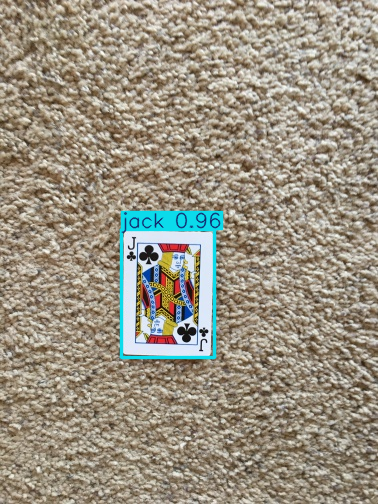

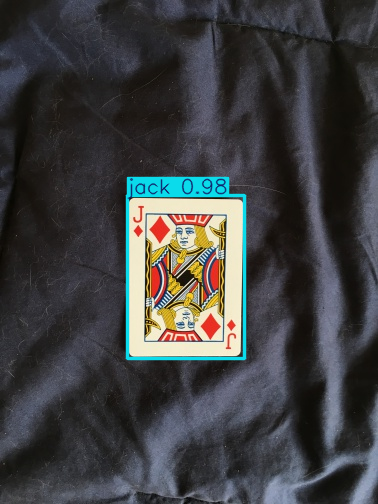

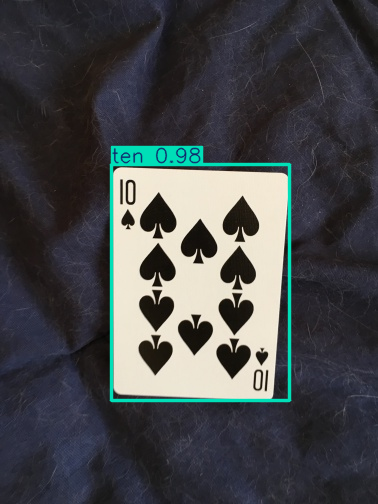

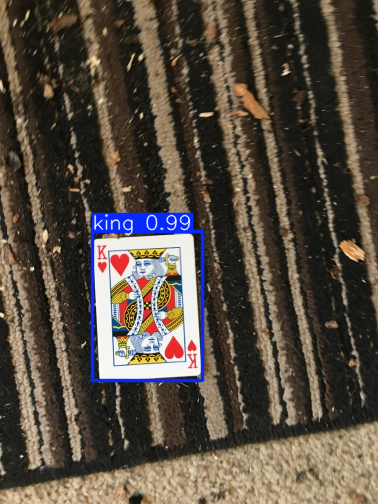

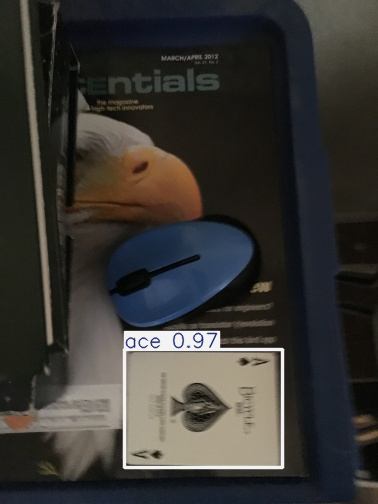

...

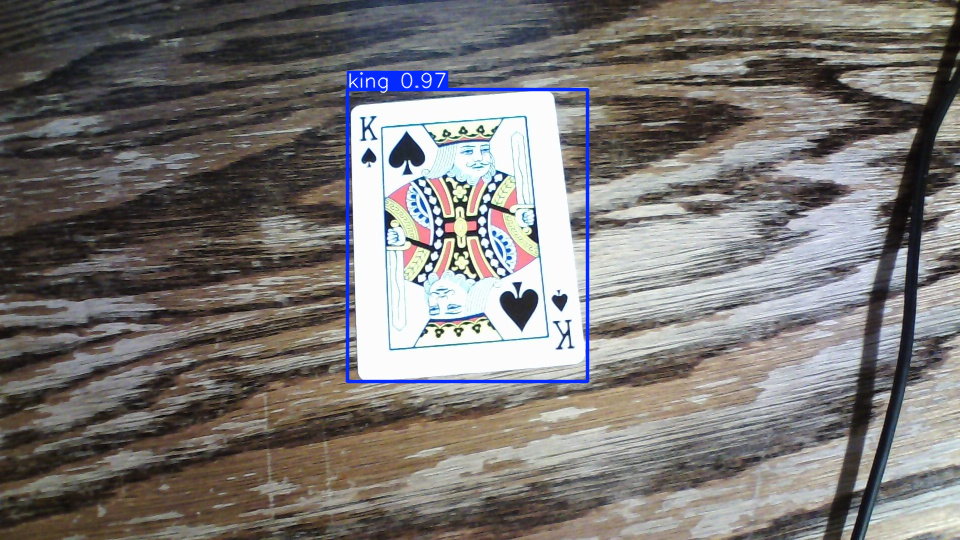

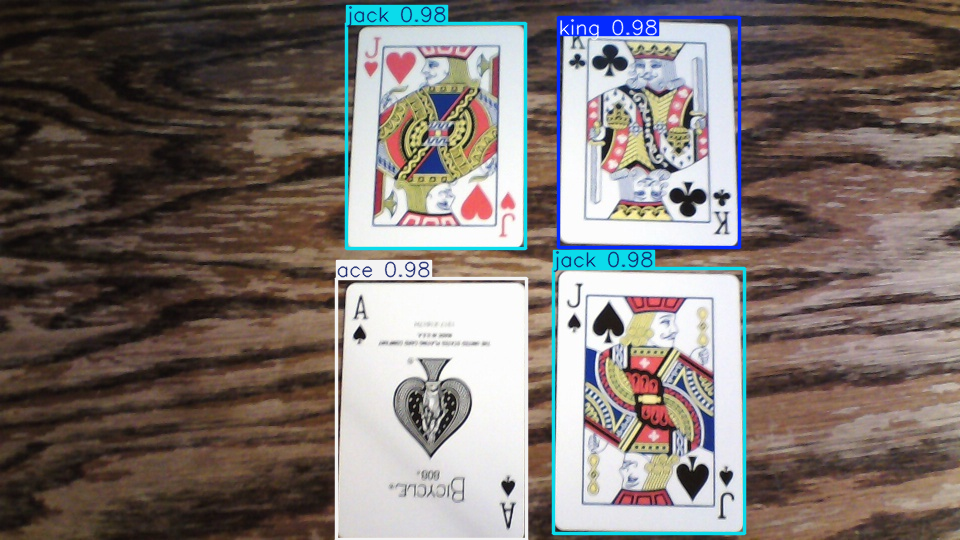

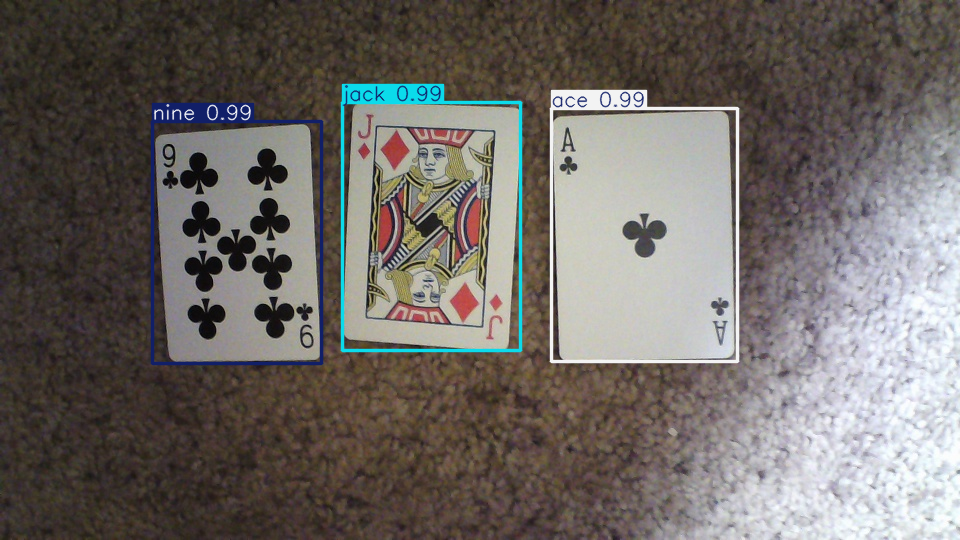

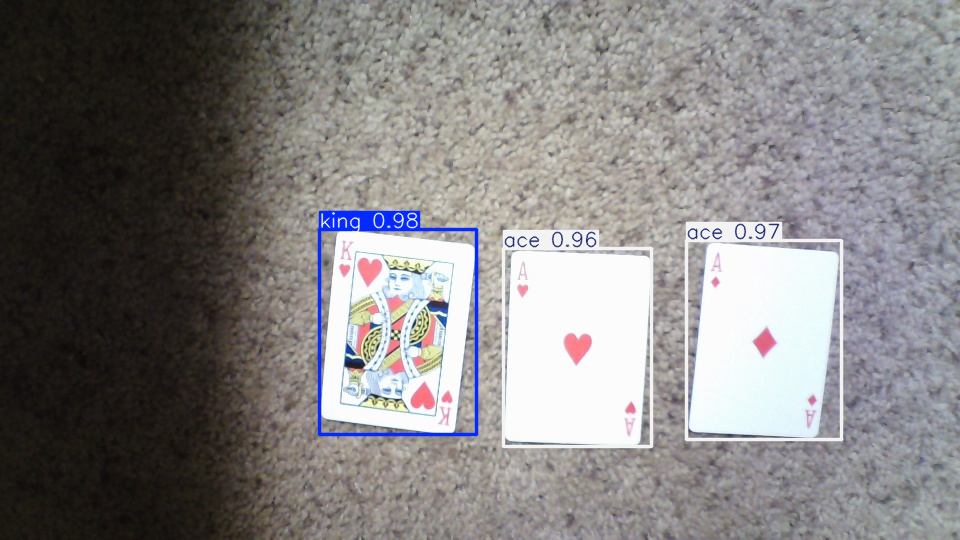

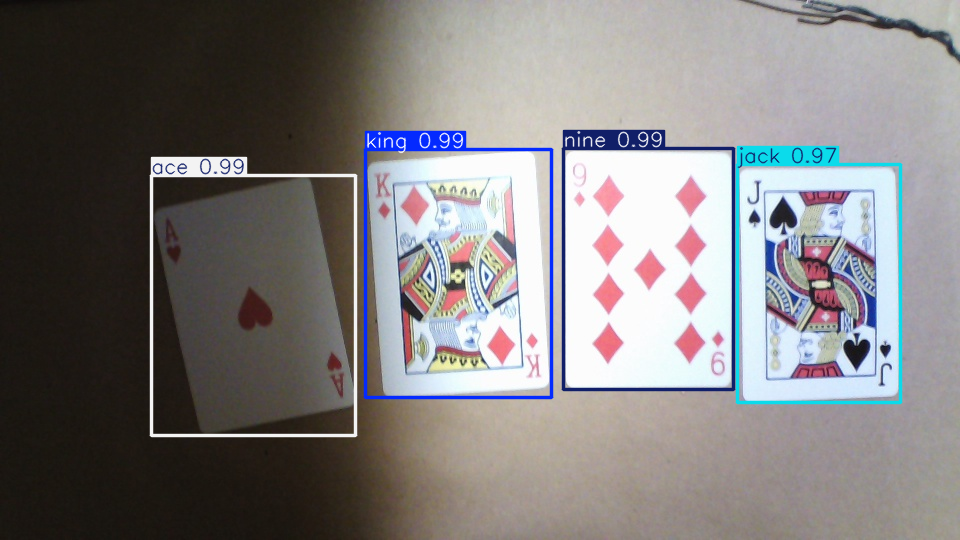

In [ ]:
results = model.predict(source="valid/images")
for result in results:
    result.show()

## Скачивание модели

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!mkdir /content/my_model
!cp /content/runs/detect/train2/weights/best.pt /content/my_model/my_model.pt
!cp -r /content/runs/detect/train2 /content/my_model

/content/my_model
  adding: my_model.pt (deflated 9%)
	zip warning: name not matched: train

zip error: Nothing to do! (try: zip -r /content/my_model.zip . -i train)
/content


In [ ]:
%cd my_model
!zip /content/my_model.zip my_model.pt
!zip -r /content/my_model.zip train2
%cd /content

/content/my_model
updating: my_model.pt (deflated 9%)
  adding: train2/ (stored 0%)
  adding: train2/results.png (deflated 7%)
  adding: train2/confusion_matrix.png (deflated 35%)
  adding: train2/F1_curve.png (deflated 10%)
  adding: train2/val_batch0_pred.jpg (deflated 7%)
  adding: train2/train_batch1.jpg (deflated 3%)
  adding: train2/results.csv (deflated 61%)
  adding: train2/labels.jpg (deflated 32%)
  adding: train2/P_curve.png (deflated 13%)
  adding: train2/confusion_matrix_normalized.png (deflated 29%)
  adding: train2/train_batch0.jpg (deflated 3%)
  adding: train2/train_batch1052.jpg (deflated 8%)
  adding: train2/val_batch0_labels.jpg (deflated 7%)
  adding: train2/args.yaml (deflated 53%)
  adding: train2/PR_curve.png (deflated 24%)
  adding: train2/train_batch2.jpg (deflated 3%)
  adding: train2/train_batch1050.jpg (deflated 10%)
  adding: train2/events.out.tfevents.1738358683.ec720a2d632b.2251.0 (deflated 89%)
  adding: train2/train_batch1051.jpg (deflated 11%)
  addin

## Инференс на потоке с веб-камеры

Так как в колабе проблематично развернуть поток с веб-камеры, воспользуемся локальной машиной и дистрибутивом Anaconda.

1. Скачаем и установим Анаконду  https://anaconda.com/download

2. Создадим и активируем виртуальную среду

```
conda create --name yolo-env1 python=3.12 -y
conda activate yolo-env1
```
3. Установим ultralytics с необходимыми библиотеками


```
pip install ultralytics
```

4. Установим GPU версию PyTorch

```
pip install --upgrade torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu124
```

5. Перейдем в директорию, куда разархивировали скаченную модель из текущей тетрадки


```
cd path/to/folder
```

6. Установим скрипт yolo_detect.py в папку с моделью, позволяющий инициализировать веб-камеру с помощью OpenCV

```
curl -o yolo_detect.py https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/yolo_detect.py
```

7. Запускаем скрипт, выбрав обученную на нашем датасете модель и устройство ввода (веб-камеру)

```
python yolo_detect.py --model my_model.pt --source usb0 --resolution 1280x720
```




